In [6]:
using JLD2
#using Makie
using Plots #CairoMakie
using LaTeXStrings

In [2]:
fn1 = "data/UV_full_U0.1_V1.0.jld2"
fn2 = "data/UV_full_U0.5_V0.75.jld2";
fn3 = "data/UV_full_U4.0_V0.5.jld2"
fn5 = "data/UV_full_U3.5_V0.5.jld2"
fn6 = "data/UV_full_U6.0_V0.5.jld2"
fn7 = "data/UV_full_U1.0_V0.5.jld2"

"data/UV_full_U1.0_V0.5.jld2"

In [3]:
function parse_file(fn)
    UList, VList, f_grid, f_ampl_lim, rho11_ampl_lim, rho11_grid = jldopen(fn, "r") do f
        f["UList"], f["VList"], f["f_up_lim"], f["f_ampl_lim"], f["rho11_ampl_lim"], f["rho11_lim"]
    end;
    
    UList_2 = sort(unique(UList))
    VList_2 = sort(unique(VList))
    f_grid2 = Matrix{Float64}(undef, length(UList_2), length(VList_2))
    f_ampl_grid2 = Matrix{Float64}(undef, length(UList_2), length(VList_2))
    rho11_ampl_grid2 = Matrix{Float64}(undef, length(UList_2), length(VList_2))
    rho11_grid2 = Matrix{Float64}(undef, length(UList_2), length(VList_2))
    exclude_rows = []
    exclude_Ui = []
    for (i,Ui) in enumerate(UList_2)
        rr = findall(x->x≈Ui, UList)
        if length(VList_2) != length(VList[rr])
            println("U = $Ui @ $i: ", length(VList_2), " ", length(VList[rr]))
            println(round.(setdiff(VList_2, VList[rr]),digits=2))
            println(round.(setdiff(VList[rr], VList_2),digits=2))
            push!(exclude_rows,i)
            push!(exclude_Ui,Ui)
        else
            Vii = sortperm(VList[rr])
            f_grid2[i,:] = f_grid[rr][Vii]
            rho11_grid2[i,:] = rho11_grid[rr][Vii]
            rho11_ampl_grid2[i,:] = rho11_ampl_lim[rr][Vii]
            f_ampl_grid2[i,:] = f_ampl_lim[rr][Vii]
        end
    end 
    exclude_ind2 = findall(x-> .!(x in exclude_Ui), UList_2)
    UList_2 = UList_2[exclude_ind2]
    ind_f = setdiff(1:size(f_grid2,1), exclude_rows)
    f_grid2 = f_grid2[ind_f, :];
    f_ampl_grid2 = f_ampl_grid2[ind_f, :];
    rho11_grid2 = rho11_grid2[ind_f, :];
    rho11_ampl_grid2 = rho11_ampl_grid2[ind_f, :];
    exclude_ind = findall(x-> .!(x in exclude_Ui), UList)
    f_grid3 = f_grid[exclude_ind];
    UList_3 = UList[exclude_ind]
    VList_3 = VList[exclude_ind];
    return UList_2, VList_2, f_grid2, f_ampl_grid2, rho11_grid2, rho11_ampl_grid2
end

UList_1, VList_1, f_grid_1, f_ampl_grid_1, rho11_grid_1, rho11_ampl_grid_1 = parse_file(fn1);
UList_2, VList_2, f_grid_2, f_ampl_grid_2, rho11_grid_2, rho11_ampl_grid_2 = parse_file(fn2);
UList_3, VList_3, f_grid_3, f_ampl_grid_3, rho11_grid_3, rho11_ampl_grid_3 = parse_file(fn3);
UList_5, VList_5, f_grid_5, f_ampl_grid_5, rho11_grid_5, rho11_ampl_grid_5 = parse_file(fn5);
UList_6, VList_6, f_grid_6, f_ampl_grid_6, rho11_grid_6, rho11_ampl_grid_6 = parse_file(fn6);
UList_7, VList_7, f_grid_7, f_ampl_grid_7, rho11_grid_7, rho11_ampl_grid_7 = parse_file(fn7);

U = 1.793103448275862 @ 29: 259 258
[0.58]
Float64[]
U = 3.7241379310344827 @ 233: 259 518
Float64[]
Float64[]
U = 3.724137931034483 @ 234: 259 518
Float64[]
Float64[]
U = 3.9899497487437188 @ 262: 259 258
[1.99]
Float64[]
U = 0.1 @ 3: 137 136
[0.5]
Float64[]


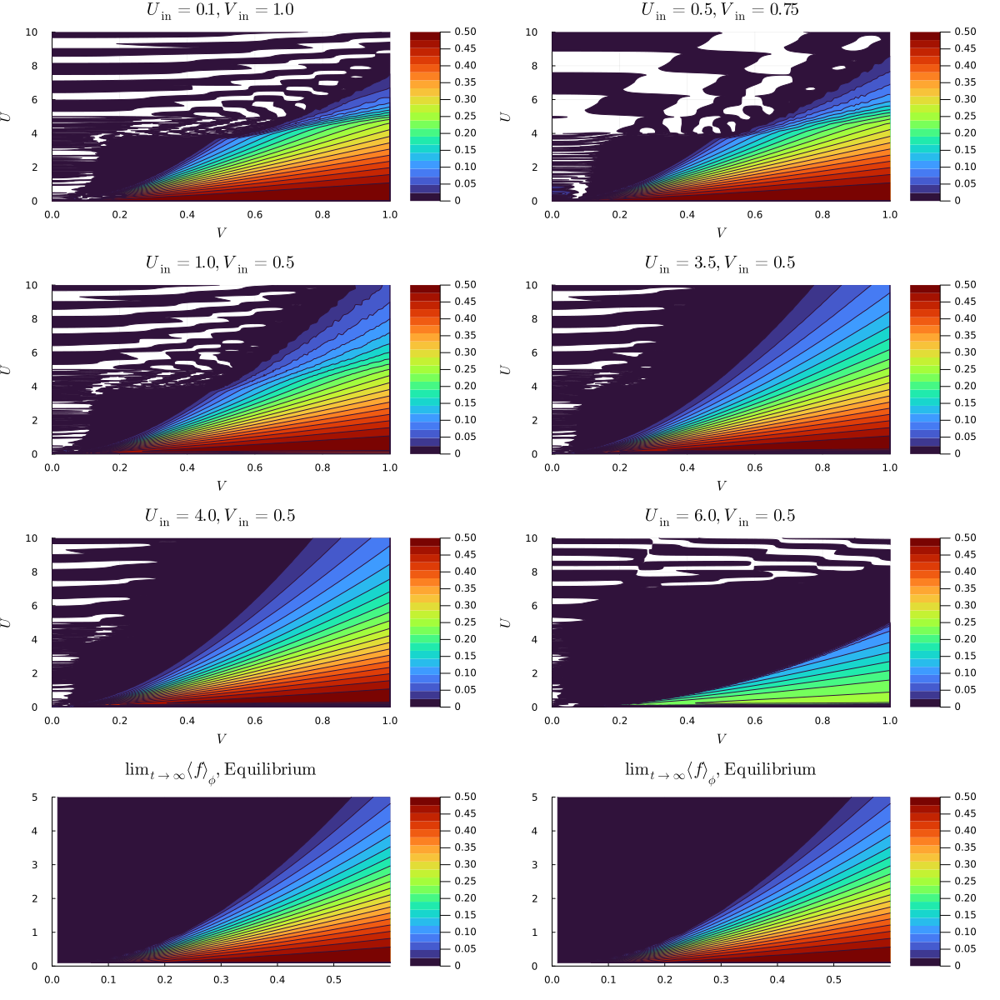

In [167]:
p1 = contourf(VList_1, UList_1, f_grid_1, clims=(-0.0,0.5), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 0.1, V_\mathrm{in} = 1.0", xlims=(0,1),ylims=(0,10.0))
p2 = contourf(VList_2, UList_2, f_grid_2, clims=(-0.0,0.5), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 0.5, V_\mathrm{in} = 0.75", xlims=(0,1),ylims=(0,10.0))
p3 = contourf(VList_3, UList_3, f_grid_3, clims=(-0.0,0.5), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 4.0, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
p5 = contourf(VList_5, UList_5, f_grid_5, clims=(-0.0,0.5), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 3.5, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
p6 = contourf(VList_6, UList_6, f_grid_6, clims=(-0.0,0.5), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 6.0, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
p7 = contourf(VList_7, UList_7, f_grid_7, clims=(-0.0,0.5), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 1.0, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
p8 = contourf(xarr, yarr, zarr, clims=(-0.0,0.5), color=:turbo, levels=20, xlims=(0,0.6),ylims=(0,5.0), title=L"\lim _{t\to\infty} \langle f \rangle_\phi, \mathrm{Equilibrium}")
p9 = contourf(xarr, yarr, zarr, clims=(-0.0,0.5), color=:turbo, levels=20, xlims=(0,0.6),ylims=(0,5.0), title=L"\lim _{t\to\infty} \langle f \rangle_\phi, \mathrm{Equilibrium}")

#p3 = heatmap(VList_2, UList_2, abs.(f_grid_1 - f_grid_2), clims=(0.0,0.3), xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \langle f \rangle_\phi", xlims=(0,1),ylims=(0,5.5))
p = plot(p1, p2, p7, p5, p3, p6, p8,p9, size=(1200,1200), layout=(4,2wqM
savefig("PD_6.pdf")
display(p)

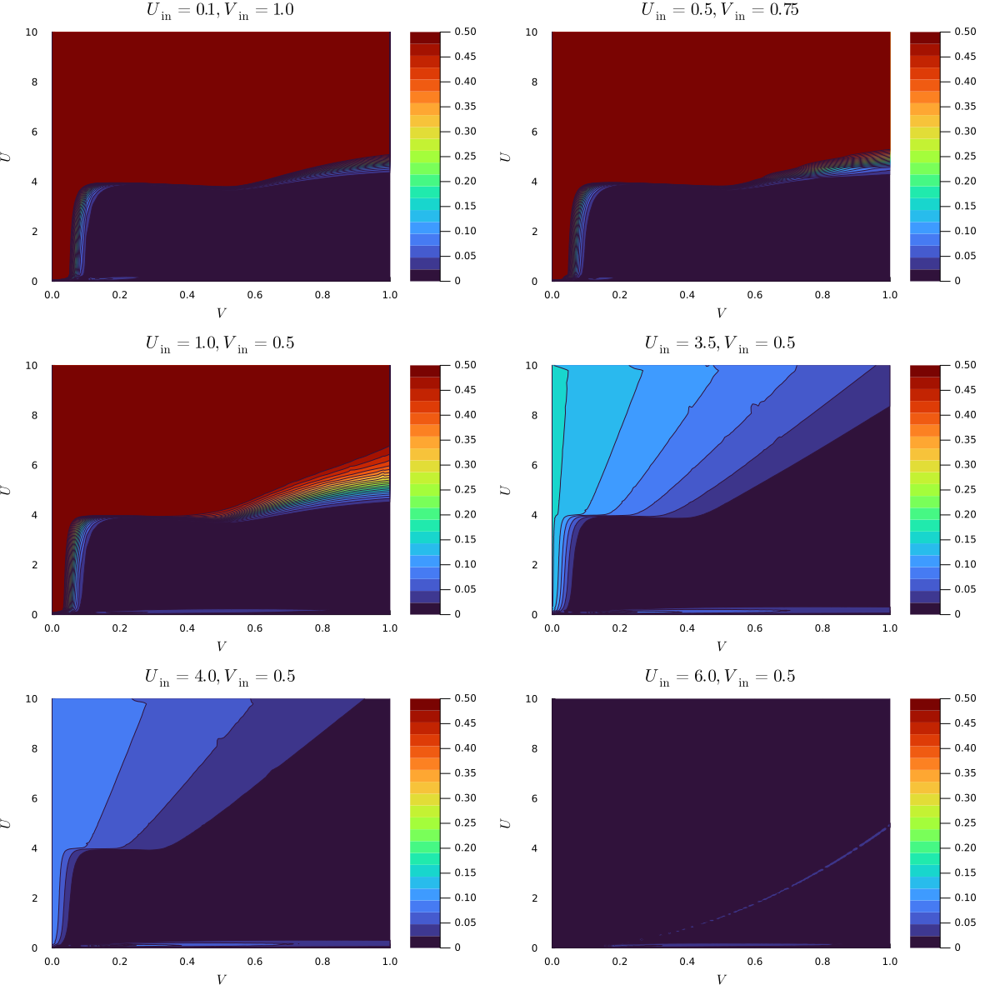

In [7]:
p1 = contourf(VList_1, UList_1, f_ampl_grid_1, color=:turbo, levels=20, clims=(0,0.5), xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 0.1, V_\mathrm{in} = 1.0", xlims=(0,1),ylims=(0,10.0))
p2 = contourf(VList_2, UList_2, f_ampl_grid_2, color=:turbo, levels=20, clims=(0,0.5), xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 0.5, V_\mathrm{in} = 0.75", xlims=(0,1),ylims=(0,10.0))
p3 = contourf(VList_3, UList_3, f_ampl_grid_3, color=:turbo, levels=20, clims=(0,0.5), xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 4.0, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
p5 = contourf(VList_5, UList_5, f_ampl_grid_5,  color=:turbo, levels=20, clims=(0,0.5), xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 3.5, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
p6 = contourf(VList_6, UList_6, f_ampl_grid_6, color=:turbo, levels=20, clims=(0,0.5), xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 6.0, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
p7 = contourf(VList_7, UList_7, f_ampl_grid_7,  color=:turbo, levels=20, clims=(0,0.5), xlabel=L"V", ylabel=L"U", title=L"U_\mathrm{in} = 1.0, V_\mathrm{in} = 0.5", xlims=(0,1),ylims=(0,10.0))
#p3 = heatmap(VList_2, UList_2, abs.(f_grid_1 - f_grid_2), clims=(0.0,0.3), xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \langle f \rangle_\phi", xlims=(0,1),ylims=(0,5.5))
p = plot(p1, p2, p7, p5, p3, p6, size=(1200,1200), layout=(3,2))
savefig("PD_ampl_6.pdf")
display(p)

In [138]:
using DelimitedFiles
arr = open("/home/julisn/Hamburg/Projects/MFDecoupling/data/Main_Results_Full.dat","r") do f
    readdlm(f)
end;
xarr = unique(arr[:,2])
yarr = unique(arr[:,1])
zarr= arr[:,4] ./ arr[:,2];

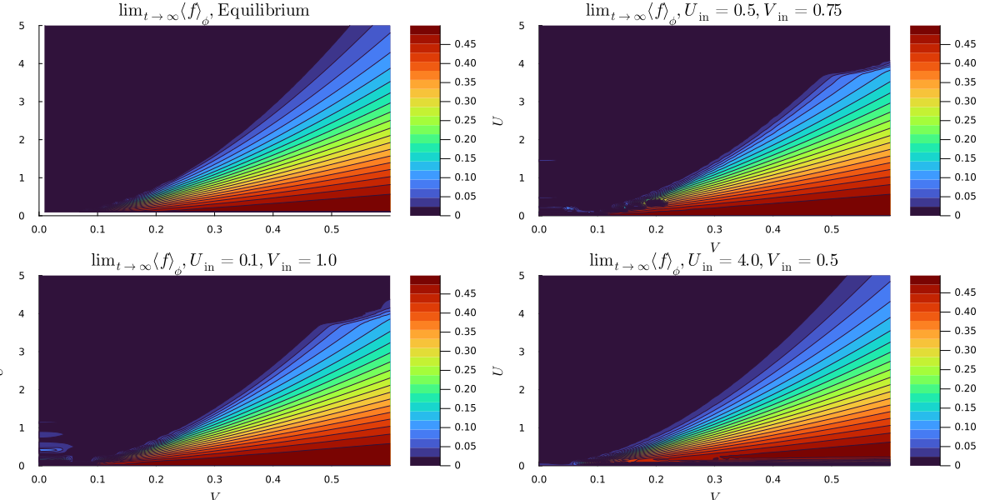

In [139]:
p1 = contourf(xarr, yarr, zarr, color=:turbo, levels=20, xlims=(0,0.6),ylims=(0,5.0), title=L"\lim _{t\to\infty} \langle f \rangle_\phi, \mathrm{Equilibrium}")
p2 = contourf(VList_1, UList_1, clamp.(f_grid_1, 0, Inf), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \langle f \rangle_\phi, U_\mathrm{in} = 0.5, V_\mathrm{in} = 0.75", xlims=(0,0.6),ylims=(0,5.0))
p3 = contourf(VList_2, UList_2, clamp.(f_grid_2, 0, Inf), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \langle f \rangle_\phi, U_\mathrm{in} = 0.1, V_\mathrm{in} = 1.0", xlims=(0,0.6),ylims=(0,5.0))
p4 = contourf(VList_3, UList_3, clamp.(f_grid_3, 0, Inf), color=:turbo, levels=20, xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \langle f \rangle_\phi, U_\mathrm{in} = 4.0, V_\mathrm{in} = 0.5", xlims=(0,0.6),ylims=(0,5.0))

plot(p1, p2, p3 ,p4, layout=(2,2), size=(1200,600))

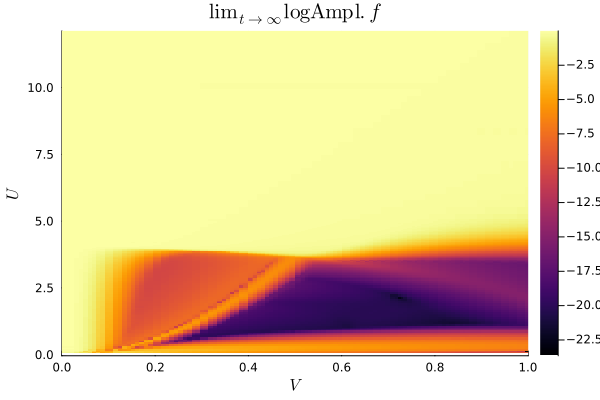

In [76]:
f = heatmap(VList_2, UList_2, log.(f_ampl_grid2), xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \log \mathrm{Ampl.} f ", xlims=(0,1.0))

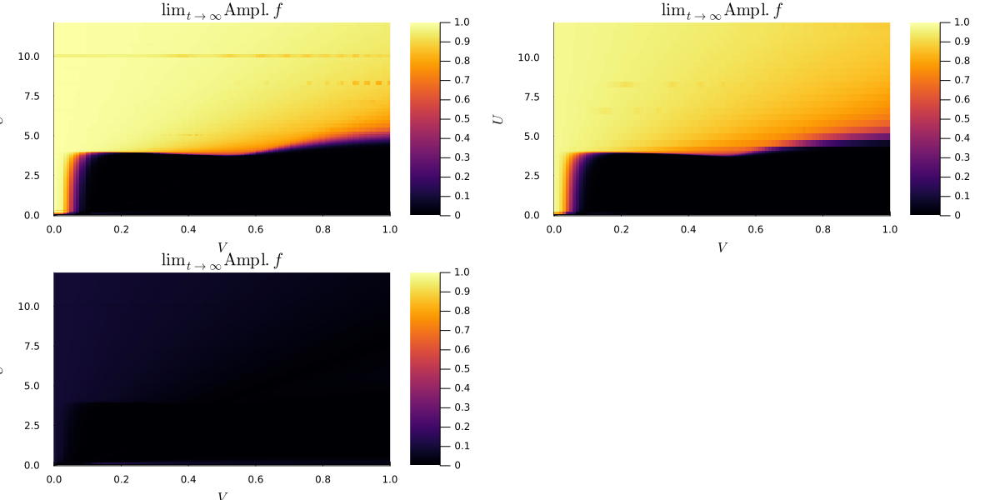

In [175]:
p1 = heatmap(VList_1, UList_1, f_ampl_grid_1, xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \mathrm{Ampl.} f ", xlims=(0,1.0), clims=(0,1))
p2 = heatmap(VList_2, UList_2, f_ampl_grid_2, xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \mathrm{Ampl.} f ", xlims=(0,1.0), clims=(0,1))
p3 = heatmap(VList_3, UList_3, f_ampl_grid_3, xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \mathrm{Ampl.} f ", xlims=(0,1.0), clims=(0,1))

plot(p1, p2, p3, size=(1200,600))

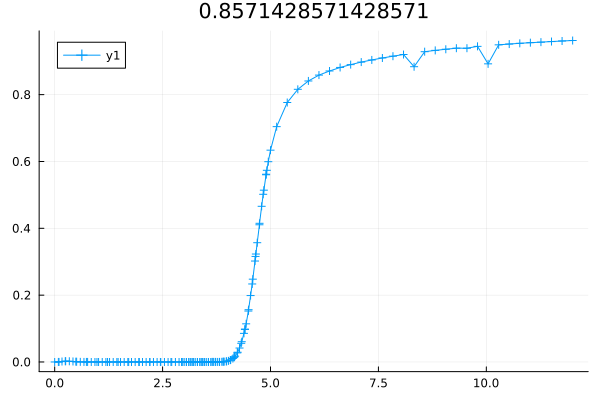

In [77]:
plot(UList_2, f_ampl_grid2[:,106], markershape=:auto, title="$(VList_2[106])")

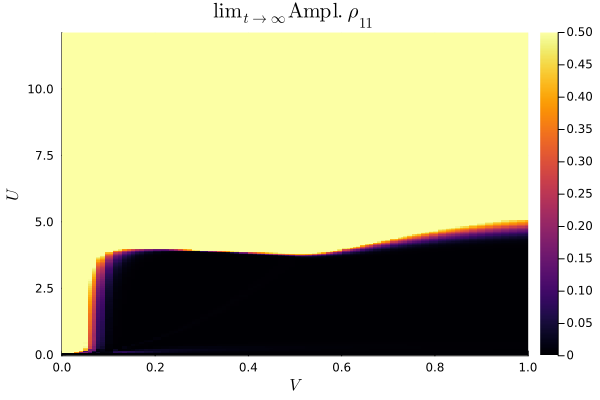

In [78]:
f = heatmap(VList_2, UList_2, f_ampl_grid2, xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \mathrm{Ampl.} \rho_{11} ", xlims=(0,1), clims=(0,0.5))

In [17]:
any(f_ampl_grid2 .> 0.01)

false

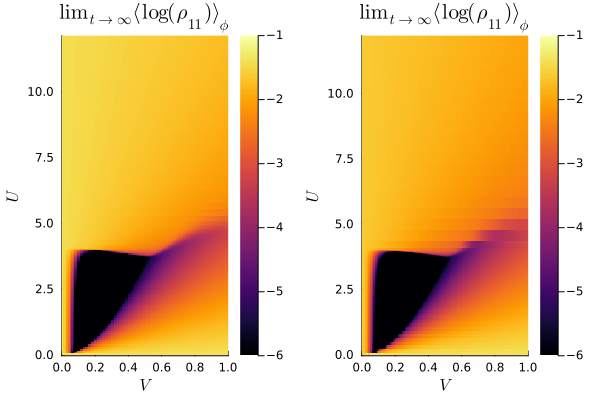

In [95]:
p1 = heatmap(VList_1, UList_1, log.(rho11_grid_1), xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \langle \log (\rho_{11}) \rangle_\phi", clims=(-6,-1), xlims=(0,1), interpolate=false)
p2 = heatmap(VList_2, UList_2, log.(rho11_grid_2), xlabel=L"V", ylabel=L"U", title=L"\lim _{t\to\infty} \langle \log (\rho_{11}) \rangle_\phi", clims=(-6,-1), xlims=(0,1), interpolate=false)
plot(p1, p2)

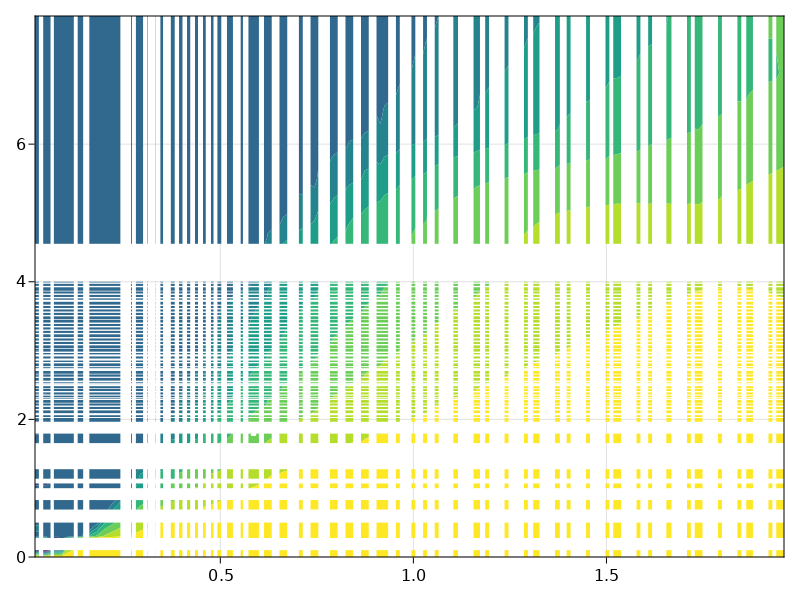

In [51]:
contourf(VList, UList, f_grid, extendlow = :auto, extendhigh = :auto)

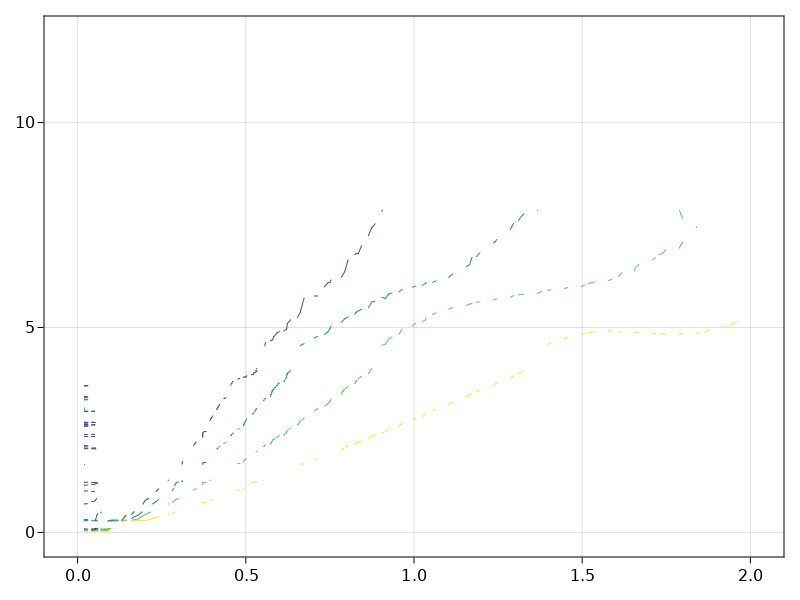

In [52]:
contour(VList,contourf(VList, UList, f_grid, extendlow = :auto, extendhigh = :auto)UList, f_grid, extendlow = :auto, extendhigh = :auto)

In [55]:
meshscatter(VList, UList, f_grid)

FigureAxisPlot()

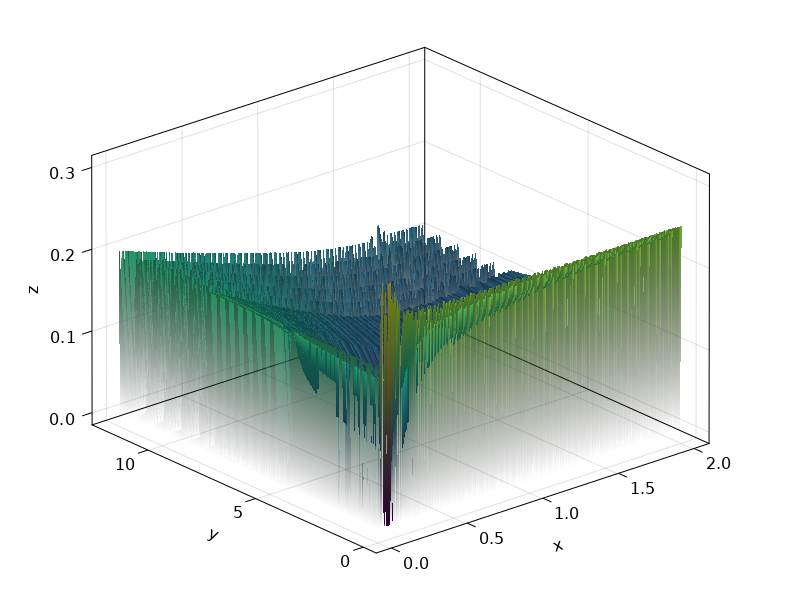

In [61]:
surface(VList, UList, rho11_grid, axis=(type=Axis3,))

In [64]:
findfirst(x->x ≈ 10.0, UList)